<a href="https://colab.research.google.com/github/entc-17-fyp-20/CM_Data_Visualizing/blob/samal/outlier_detection_IQR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from numpy.random import seed

import plotly.express as px
import plotly.graph_objects as go

In [ ]:
url1 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/S6%2010%20seconed%20data.csv' #S6 10 seconed data.csv
url2 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/AE59_1.csv' #AE59_1
url3 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/AE59_2.csv' #AE59_2
url4 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/V08%20June%2010%20sec%20data.csv' #V08 June 10 sec data.csv
url5 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/V13%20June%2010%20sec%20data.csv' #V13 June 10 sec data.csv
url6 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/V08%20July%2010%20sec%20data.csv' #V08 July 10 sec data.csv
url7 = 'https://raw.githubusercontent.com/entc-17-fyp-20/Datasets/main/V13%20July%2010%20sec%20data.csv' #V13 July 10 sec data.csv

In [ ]:
df5 = pd.read_csv(url5)
df5["voltage"] = (df5["Voltage Phase R"] + df5["Voltage Phase S"]+ df5["Voltage Phase T"])/3
df5["current"]  = (df5["Current Phase R"] + df5["Current Phase S"]+ df5["Current Phase T"])/3
df5["Gearbox & Bearing temp"]  = (df5["Gearbox Bearing Temperature"] + df5["Gearbox oil Temperature"]+ df5["Generator Winding Temperature R"]+df5["Generator Winding Temperature S"]+df5["Generator Winding Temperature T"]+df5["Main bearing Temperature"] + df5["Generator Bearing Temperature DE"]+ df5["Generator Bearing Temperature NDE"])/8


df5.drop(["Reactive Power kVAR", "Frequency Hz","Voltage Phase R","Voltage Phase S","Voltage Phase T","Current Phase R","Current Phase S","Current Phase T","Gearbox Bearing Temperature","Gearbox oil Temperature","Generator Winding Temperature R","Generator Winding Temperature S","Generator Winding Temperature T","Main bearing Temperature","Generator Bearing Temperature DE","Generator Bearing Temperature NDE"], axis='columns', inplace=True)

In [ ]:
df5.head()

,Date & Time,Active Power kW,Wind Speed m/s,Nacelle Temperature,Ambient Temperature,Hydraulic unit Pressure in bar,Hydraulic oil Temperature,Generator RPM,voltage,current,Gearbox & Bearing temp
0,02/06/2021 00:00:00,385.9,8.4,30.8,30.6,168.8,45.9,1408.4,574.700000,231.500000,82.8000
1,02/06/2021 00:00:10,299.0,8.3,30.8,30.6,172.3,45.8,1392.7,574.000000,187.533333,82.7375
2,02/06/2021 00:00:20,344.3,8.2,30.8,30.5,168.0,45.8,1439.5,574.766667,195.200000,82.9000
3,02/06/2021 00:00:30,426.5,8.4,30.8,30.5,173.9,45.9,1491.7,575.133333,248.866667,82.6875
4,02/06/2021 00:00:40,546.0,9.2,30.8,30.6,166.8,45.8,1497.7,575.533333,309.733333,82.8250


In [ ]:
df_new = pd.DataFrame()
df_new["Date & Time"] = df5['Date & Time']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



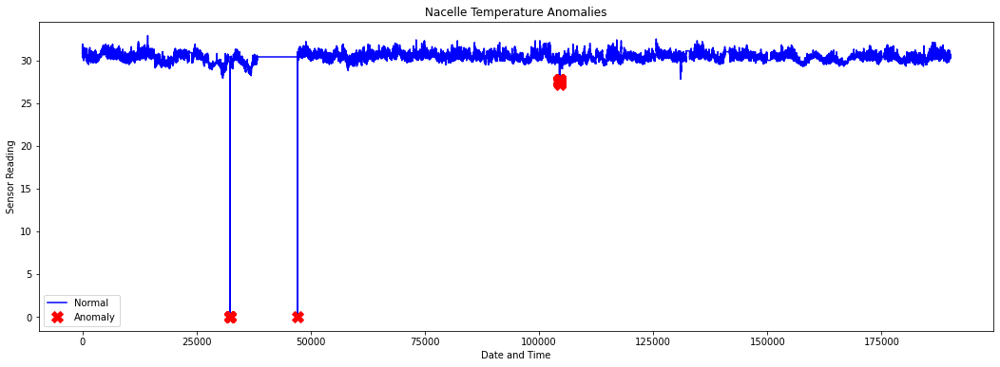

In [ ]:
column_name= 'Nacelle Temperature'
df =df5[['Date & Time',column_name]]
q1_pc1, q3_pc1 = df[column_name].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1
lower_pc1 = q1_pc1 - (4*iqr_pc1)
upper_pc1 = q3_pc1 + (4*iqr_pc1)

df['anomaly_1'] = ((df[column_name]>upper_pc1) | (df[column_name]<lower_pc1)).astype('int')


a = df[df['anomaly_1'] == 1] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(df[column_name], color='blue', label='Normal')
_ = plt.plot(a[column_name], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title(column_name+ ' Anomalies')
_ = plt.legend(loc='best')
plt.show();

In [ ]:
df['MA48'] = df[column_name].rolling(200).mean()
df['MA48'] = df['MA48'].fillna(0);

df_new[column_name] = df['MA48'].values*df['anomaly_1'].values+df[column_name].values*(1-df['anomaly_1'].values) 
df_new

fig = px.line(df5, x="Date & Time" , y=column_name) 
fig.show()

fig = px.line(df_new, x="Date & Time" , y=column_name) 
fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



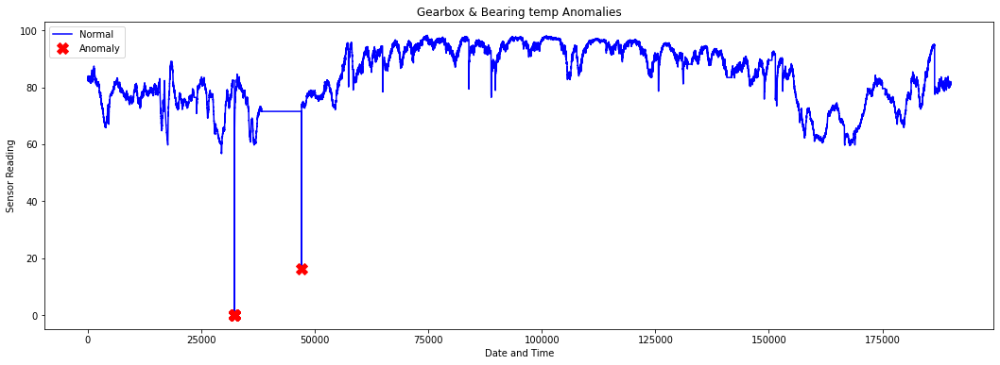

In [ ]:
column_name = 'Gearbox & Bearing temp'
df =df5[['Date & Time',column_name]]
q1_pc1, q3_pc1 = df[column_name].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1
lower_pc1 = q1_pc1 - (1.5*iqr_pc1)
upper_pc1 = q3_pc1 + (1.5*iqr_pc1)

df['anomaly_1'] = ((df[column_name]>upper_pc1) | (df[column_name]<lower_pc1)).astype('int')


a = df[df['anomaly_1'] == 1] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(df[column_name], color='blue', label='Normal')
_ = plt.plot(a[column_name], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title(column_name+ ' Anomalies')
_ = plt.legend(loc='best')
plt.show();

In [ ]:
df['MA48'] = df[column_name].rolling(200).mean()
df['MA48'] = df['MA48'].fillna(0);

df_new[column_name] = df['MA48'].values*df['anomaly_1'].values+df[column_name].values*(1-df['anomaly_1'].values) 
df_new

fig = px.line(df5, x="Date & Time" , y=column_name) 
fig.show()

fig = px.line(df_new, x="Date & Time" , y=column_name) 
fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
column_name = 'Ambient Temperature'
df =df5[['Date & Time',column_name]]
q1_pc1, q3_pc1 = df[column_name].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1
lower_pc1 = q1_pc1 - (3*iqr_pc1)
upper_pc1 = q3_pc1 + (3*iqr_pc1)

df['anomaly_1'] = ((df[column_name]>upper_pc1) | (df[column_name]<lower_pc1)).astype('int')


a = df[df['anomaly_1'] == 1] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(df[column_name], color='blue', label='Normal')
_ = plt.plot(a[column_name], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title(column_name+ ' Anomalies')
_ = plt.legend(loc='best')
plt.show();

In [ ]:
df['MA48'] = df[column_name].rolling(200).mean()
df['MA48'] = df['MA48'].fillna(0);

df_new[column_name] = df['MA48'].values*df['anomaly_1'].values+df[column_name].values*(1-df['anomaly_1'].values) 
df_new

fig = px.line(df5, x="Date & Time" , y=column_name) 
fig.show()

fig = px.line(df_new, x="Date & Time" , y=column_name) 
fig.show()

In [ ]:
column_name = 'Hydraulic unit Pressure in bar'
df =df5[['Date & Time',column_name]]
q1_pc1, q3_pc1 = df[column_name].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1
lower_pc1 = q1_pc1 - (1.5*iqr_pc1)
upper_pc1 = q3_pc1 + (1.5*iqr_pc1)

df['anomaly_1'] = ((df[column_name]>upper_pc1) | (df[column_name]<lower_pc1)).astype('int')


a = df[df['anomaly_1'] == 1] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(df[column_name], color='blue', label='Normal')
_ = plt.plot(a[column_name], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title(column_name+ ' Anomalies')
_ = plt.legend(loc='best')
plt.show();

In [ ]:
df['MA48'] = df[column_name].rolling(200).mean()
df['MA48'] = df['MA48'].fillna(0);

df_new[column_name] = df['MA48'].values*df['anomaly_1'].values+df[column_name].values*(1-df['anomaly_1'].values) 
df_new

fig = px.line(df5, x="Date & Time" , y=column_name) 
fig.show()

fig = px.line(df_new, x="Date & Time" , y=column_name) 
fig.show()

In [ ]:
column_name = 'Hydraulic oil Temperature'
df =df5[['Date & Time',column_name]]
q1_pc1, q3_pc1 = df[column_name].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1
lower_pc1 = q1_pc1 - (2*iqr_pc1)
upper_pc1 = q3_pc1 + (2*iqr_pc1)

df['anomaly_1'] = ((df[column_name]>upper_pc1) | (df[column_name]<lower_pc1)).astype('int')


a = df[df['anomaly_1'] == 1] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(df[column_name], color='blue', label='Normal')
_ = plt.plot(a[column_name], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title(column_name+ ' Anomalies')
_ = plt.legend(loc='best')
plt.show();

In [ ]:
df['MA48'] = df[column_name].rolling(200).mean()
df['MA48'] = df['MA48'].fillna(0);

df_new[column_name] = df['MA48'].values*df['anomaly_1'].values+df[column_name].values*(1-df['anomaly_1'].values) 
df_new

fig = px.line(df5, x="Date & Time" , y=column_name) 
fig.show()

fig = px.line(df_new, x="Date & Time" , y=column_name) 
fig.show()

,Date & Time,Nacelle Temperature,Gearbox & Bearing temp,Ambient Temperature,Hydraulic unit Pressure in bar,Hydraulic oil Temperature
0,02/06/2021 00:00:00,30.8,82.8000,30.6,168.8,45.9
1,02/06/2021 00:00:10,30.8,82.7375,30.6,172.3,45.8
2,02/06/2021 00:00:20,30.8,82.9000,30.5,168.0,45.8
3,02/06/2021 00:00:30,30.8,82.6875,30.5,173.9,45.9
4,02/06/2021 00:00:40,30.8,82.8250,30.6,166.8,45.8
...,...,...,...,...,...,...
190033,30/06/2021 23:43:10,30.6,82.0375,30.9,171.6,45.5
190034,30/06/2021 23:43:20,30.7,81.9375,30.8,167.9,45.6
190035,30/06/2021 23:43:30,30.6,81.9375,30.7,174.8,45.5
190036,30/06/2021 23:43:40,30.7,81.8250,30.6,166.5,45.5
